<a href="https://colab.research.google.com/github/Jai14/FYP/blob/main/fyp_test.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Import

In [5]:
pip install opencv-python-headless

  Using cached opencv_python_headless-4.9.0.80-cp37-abi3-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (20 kB)
Using cached opencv_python_headless-4.9.0.80-cp37-abi3-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (49.6 MB)
Note: you may need to restart the kernel to use updated packages.


In [6]:
pip install -U albumentations

  Using cached annotated_types-0.6.0-py3-none-any.whl.metadata (12 kB)
  Using cached pydantic_core-2.18.1-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (6.5 kB)
Using cached pydantic_core-2.18.1-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (2.1 MB)
Using cached annotated_types-0.6.0-py3-none-any.whl (12 kB)
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
dataproc-jupyter-plugin 0.1.74 requires pydantic~=1.10.0, but you have pydantic 2.7.0 which is incompatible.
ydata-profiling 4.6.0 requires pydantic<2,>=1.8.1, but you have pydantic 2.7.0 which is incompatible.
Note: you may need to restart the kernel to use updated packages.


In [47]:
import torch
import cv2
import shutil
import os
import zipfile
import gzip
import random
from pprint import pprint

from sklearn.model_selection import train_test_split

import torchvision.transforms as T
from torchvision.datasets import ImageFolder
from torchvision.transforms import ToTensor
import torchvision.transforms.functional as TF
import torchvision.models as models

from torch.utils.data import Dataset
from torch.utils.data import DataLoader
import torch.nn as nn
import torch.optim as optim

import albumentations as A
from albumentations.pytorch import ToTensorV2

from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import KFold

import numpy as np
import matplotlib.pyplot as plt
import random

from sklearn.metrics import confusion_matrix
import seaborn as sns
import pickle
import time
import pandas as pd
import statistics

In [8]:
if torch.cuda.is_available():
    # Get the number of available GPUs
    num_gpus = torch.cuda.device_count()

    print(f"Number of available GPUs: {num_gpus}")

    for i in range(num_gpus):
        print(f"GPU {i}: {torch.cuda.get_device_name(i)}")

    current_device = torch.cuda.current_device()
    print(f"\nPyTorch is currently using GPU: {torch.cuda.get_device_name(current_device)}")
else:
    print("No GPU available. PyTorch is using CPU.")

Number of available GPUs: 1
GPU 0: Tesla T4

PyTorch is currently using GPU: Tesla T4


# Load dataset

In [9]:
# Define the directory path
directory = 'training_set/'

# Function to recursively find image files in subfolders
def find_images(directory):
    image_files = []
    for root, dirs, files in os.walk(directory):
        for file in files:
            # Check if the file has an image extension
            if file.lower().endswith(('.png', '.jpg', '.jpeg', '.gif', '.bmp')):
                image_files.append(os.path.join(root, file))
    return image_files

# Find all image files in subfolders
all_image_paths = find_images(directory)

In [10]:
all_image_paths_sorted = sorted(all_image_paths)

In [11]:
pprint(all_image_paths_sorted[0])
len(all_image_paths_sorted)

'training_set/NO/img_16990.jpg'


1800

In [12]:
class image_Dataset(Dataset):
    def __init__(self, image_paths, tensor_encoded_labels, transform=None):
        """
        Args:
            image_paths (list): List of file paths to images.
            labels (list): List of labels corresponding to the images.
            transform (callable, optional): Optional transform to be applied on a sample.
        """
        self.image_paths = image_paths
        self.labels = tensor_encoded_labels
        self.transform = transform


    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        image_filepath = self.image_paths[idx]
        image = cv2.imread(image_filepath)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        if self.transform is not None and callable(self.transform):
            image = self.transform(image=image)["image"]

        # Convert label to PyTorch tensor
        label = self.labels[idx]

        return image, label

# Split train/test

In [13]:
train_x = all_image_paths_sorted
train_y = [path.split('/')[-2] for path in all_image_paths_sorted]
train_x, test_x, train_y, test_y = train_test_split(train_x, train_y, test_size=0.2, random_state=5, stratify=train_y)

In [14]:
count_train = len(train_y)
count_yes_train = train_y.count("YES")
count_no_train = train_y.count("NO")

print("Number of total train :", count_train)
print("Number of 'yes':", count_yes_train)
print("Number of 'no':", count_no_train)

Number of total train : 1440
Number of 'yes': 720
Number of 'no': 720


In [15]:
count_test = len(test_y)
count_yes_train = test_y.count("YES")
count_no_train = test_y.count("NO")

print("Number of total test :", count_test)
print("Number of 'yes':", count_yes_train)
print("Number of 'no':", count_no_train)

Number of total test : 360
Number of 'yes': 180
Number of 'no': 180


In [16]:
# Initialize the label encoder
label_encoder = LabelEncoder()

# Fit label encoder and transform labels
encoded_labels_train = label_encoder.fit_transform(train_y)
tensor_encoded_labels_train = torch.tensor(encoded_labels_train)
pprint(tensor_encoded_labels_train)


# Fit label encoder and transform labels
encoded_labels_test = label_encoder.fit_transform(test_y)
tensor_encoded_labels_test = torch.tensor(encoded_labels_test)
pprint(tensor_encoded_labels_test)

tensor([0, 0, 1,  ..., 0, 0, 0])
tensor([1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1,
        1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0,
        1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1,
        1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0,
        0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1,
        1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0,
        0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0,
        0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1,
        1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0,
        0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0,
        0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1,
       

# Transform

In [17]:
transforms = A.Compose(
    [
        A.Resize(height=300, width=300), # Resize to 300x300"
        A.ToFloat(),
        ToTensorV2(),
    ]
)

# Dataset Loading

In [18]:
#######################################################
#                  Create Dataset
#######################################################

train_dataset = image_Dataset(train_x,tensor_encoded_labels_train,transforms)
test_dataset = image_Dataset(test_x,tensor_encoded_labels_test,transforms)

In [19]:
#######################################################
#                  load Dataset
#######################################################

train_loader = DataLoader(train_dataset, batch_size=8, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=8, shuffle=True)

# Model Definition

In [20]:
class ImageClassifier(nn.Module):
    def __init__(self, num_classes=2):
        super().__init__()
        self.conv_layer_1 = nn.Sequential(
            nn.Conv2d(in_channels=3, out_channels=64, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.BatchNorm2d(64),
            nn.MaxPool2d(3))
        self.conv_layer_2 = nn.Sequential(
            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.BatchNorm2d(128),
            nn.MaxPool2d(3))
        self.classifier = nn.Sequential(
            nn.Flatten(),
            nn.Linear(in_features=128*33*33, out_features=num_classes))

    def forward(self, x: torch.Tensor):
        x = self.conv_layer_1(x)
        x = self.conv_layer_2(x)
        x = self.classifier(x)
        return x


In [21]:
class ImageClassifier_V2(nn.Module):
    def __init__(self, num_classes=2):
        super(ImageClassifier_V2, self).__init__()
        self.conv_layer_1 = nn.Sequential(
            nn.Conv2d(in_channels=3, out_channels=128, kernel_size=7, padding=3),
            nn.ReLU(),
            nn.BatchNorm2d(128),
            nn.MaxPool2d(kernel_size=3, stride=3))

        self.conv_layer_2 = nn.Sequential(
            nn.Conv2d(in_channels=128, out_channels=256, kernel_size=3, padding=2),
            nn.ReLU(),
            nn.BatchNorm2d(256),
            nn.MaxPool2d(kernel_size=3, stride=3))

        self.conv_layer_3 = nn.Sequential(
            nn.Conv2d(in_channels=256, out_channels=512, kernel_size=3, padding=2),  # Adjusted kernel_size
            nn.ReLU(),
            nn.BatchNorm2d(512),
            nn.MaxPool2d(kernel_size=3, stride=1))  # Adjusted kernel_size and stride

        # Calculate the input size for the linear layer based on the output of conv_layer_3
        self.classifier_input_size = 512*34*34  # Adjusted based on the spatial dimensions

        self.classifier = nn.Sequential(
            nn.Flatten(),
            nn.Linear(in_features=self.classifier_input_size, out_features=num_classes)
        )

    def forward(self, x: torch.Tensor):
        x = self.conv_layer_1(x)
        #print("Shape after conv_layer_1:", x.shape)

        x = self.conv_layer_2(x)

        #print("Shape after conv_layer_2:", x.shape)
        x = self.conv_layer_3(x)

        #print("Shape after conv_layer_3:", x.shape)


        x = self.classifier(x)
        return x

# Loading Models

In [22]:
modelV1_0 = torch.load("modelV1_0.pth")

In [23]:
modelV1_1 = torch.load("modelV1_1.pth")

In [24]:
modelV1_2 = torch.load("modelV1_2.pth")

In [25]:
modelV2_0 = torch.load("modelV2_0.pth", map_location=torch.device('cpu'))

In [26]:
modelV2_1 = torch.load("modelV2_1.pth", map_location=torch.device('cpu'))

In [27]:
modelV1_0.eval()
modelV1_1.eval()
modelV1_2.eval()
modelV2_0.eval()
modelV2_1.eval()

ImageClassifier_V2(
  (conv_layer_1): Sequential(
    (0): Conv2d(3, 128, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
    (1): ReLU()
    (2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): MaxPool2d(kernel_size=3, stride=3, padding=0, dilation=1, ceil_mode=False)
  )
  (conv_layer_2): Sequential(
    (0): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(2, 2))
    (1): ReLU()
    (2): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): MaxPool2d(kernel_size=3, stride=3, padding=0, dilation=1, ceil_mode=False)
  )
  (conv_layer_3): Sequential(
    (0): Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=(2, 2))
    (1): ReLU()
    (2): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): MaxPool2d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  )
  (classifier): Sequential(
    (0): Flatten(start_dim=1, end_dim=-1)
    (1): 

In [28]:
all_labels = []

for data, labels in test_loader:
    all_labels.extend(labels)
    
pprint(len(all_labels))

360


In [31]:
def toLabelClass(all_labels):
    real_labels = []
    for label in all_labels:
        encoded_true_label = int(label.item())

        # Decode the labels
        true_label_decoded = label_encoder.inverse_transform([encoded_true_label])[0]

        real_labels.append(true_label_decoded)
        
    return real_labels

In [32]:
real_labels = toLabelClass(all_labels)

In [33]:
len(real_labels)

360

In [34]:
def get_predictions(model,test_loader):  
    
    total_correct = 0
    total_samples = 0

    wrong_predictions = []
    right_predictions = []
    predicted_list = []
    elapsed_time = []
    
    with torch.no_grad():
        for images, labels in test_loader:
            # Forward pass
            images, labels = images, labels
            outputs = model(images)

            start_time = time.time()
            # Compute predictions
            _, predicted = torch.max(outputs, 1)
            end_time = time.time()
            elapsed_time.append(end_time - start_time)
            
            predicted_list.extend(predicted)
    
            # Collect wrong predictions
            for i in range(len(labels)):

                if predicted[i] != labels[i]:
                    wrong_predictions.append((images[i], labels[i], predicted[i]))
                else:
                    right_predictions.append((images[i], labels[i], predicted[i]))

            # Update total_correct and total_samples
            total_correct += (predicted == labels).sum().item()
            total_samples += labels.size(0)

    # Calculate accuracy
    accuracy = 100.0 * total_correct / total_samples
    print('Accuracy on the test set: {:.2f}%'.format(accuracy))
    
    
    return right_predictions, wrong_predictions, predicted_list, statistics.mean(elapsed_time)

In [35]:
def tensorToLabel(right_predictions,wrong_predictions):
    
    true_labels = []
    predicted_labels = []

    for image, true_label, predicted_label in wrong_predictions:
        encoded_true_label = int(true_label.item())
        encoded_predicted_label = int(predicted_label.item())

        # Decode the labels
        true_label_decoded = label_encoder.inverse_transform([encoded_true_label])[0]
        predicted_label_decoded = label_encoder.inverse_transform([encoded_predicted_label])[0]

        true_labels.append(true_label_decoded)
        predicted_labels.append(predicted_label_decoded)


    for image, true_label, predicted_label in right_predictions:
        encoded_true_label = int(true_label.item())
        encoded_predicted_label = int(predicted_label.item())

        # Decode the labels
        true_label_decoded = label_encoder.inverse_transform([encoded_true_label])[0]
        predicted_label_decoded = label_encoder.inverse_transform([encoded_predicted_label])[0]

        true_labels.append(true_label_decoded)
        predicted_labels.append(predicted_label_decoded)
    
    return true_labels,predicted_labels

In [36]:
def getConfMatrix(true,predicted,model_name):
    
    # Compute the confusion matrix
    conf_matrix = confusion_matrix(true, predicted, labels=label_encoder.classes_)
    # Convert the confusion matrix to a DataFrame for better visualization
    conf_matrix_df = pd.DataFrame(conf_matrix, index=label_encoder.classes_, columns=label_encoder.classes_)

    # Plot the confusion matrix as a heatmap
    plt.figure(figsize=(5, 4))
    sns.heatmap(conf_matrix_df, annot=True, fmt='d', cmap='Blues')
    plt.title('Confusion Matrix')
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.savefig(f'confusion_matrix_{model_name}.png')
    plt.show()

In [37]:
modelV1_0.cpu()
modelV1_1.cpu()
modelV1_2.cpu()
modelV2_0.cpu()
modelV2_1.cpu()

ImageClassifier_V2(
  (conv_layer_1): Sequential(
    (0): Conv2d(3, 128, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
    (1): ReLU()
    (2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): MaxPool2d(kernel_size=3, stride=3, padding=0, dilation=1, ceil_mode=False)
  )
  (conv_layer_2): Sequential(
    (0): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(2, 2))
    (1): ReLU()
    (2): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): MaxPool2d(kernel_size=3, stride=3, padding=0, dilation=1, ceil_mode=False)
  )
  (conv_layer_3): Sequential(
    (0): Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=(2, 2))
    (1): ReLU()
    (2): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): MaxPool2d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  )
  (classifier): Sequential(
    (0): Flatten(start_dim=1, end_dim=-1)
    (1): 

## Model V1.0

In [59]:
right_list_modelV1_0, wrong_list_modelV1_0, predicted_list_modelV1_0, elapsed_time_modelV1_0 = get_predictions(modelV1_0, test_loader)

Accuracy on the test set: 97.22%


In [98]:
elapsed_time_modelV1_0

5.522304111056858e-05

In [78]:
label_true_list_modelV1_0 ,label_predicted_list_modelV1_0  = tensorToLabel(right_list_modelV1_0,wrong_list_modelV1_0)

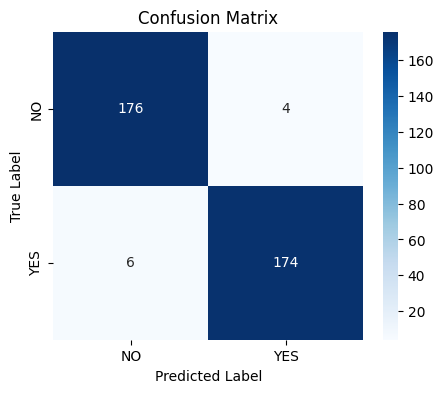

In [84]:
getConfMatrix(label_true_list_modelV1_0,label_predicted_list_modelV1_0,"ModelV1_0")

## Model V1.1

In [86]:
right_list_modelV1_1, wrong_list_modelV1_1, predicted_list_modelV1_1, elapsed_time_modelV1_1 = get_predictions(modelV1_1, test_loader)

Accuracy on the test set: 98.06%


In [97]:
elapsed_time_modelV1_1

5.941390991210937e-05

In [87]:
label_true_list_modelV1_1 ,label_predicted_list_modelV1_1  = tensorToLabel(right_list_modelV1_1,wrong_list_modelV1_1)

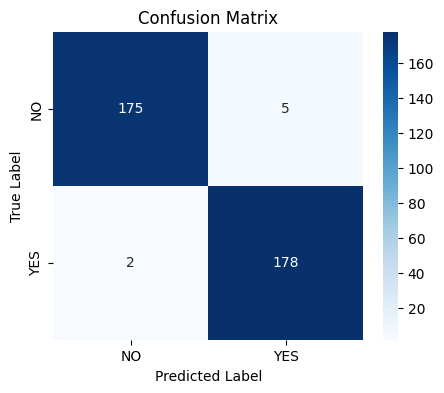

In [88]:
getConfMatrix(label_true_list_modelV1_1,label_predicted_list_modelV1_1,"ModelV1_1")

## Model V1.2

In [89]:
right_list_modelV1_2, wrong_list_modelV1_2, predicted_list_modelV1_2, elapsed_time_modelV1_2 = get_predictions(modelV1_2, test_loader)

Accuracy on the test set: 98.33%


In [96]:
elapsed_time_modelV1_2

6.138483683268229e-05

In [90]:
label_true_list_modelV1_2 ,label_predicted_list_modelV1_2  = tensorToLabel(right_list_modelV1_2,wrong_list_modelV1_2)

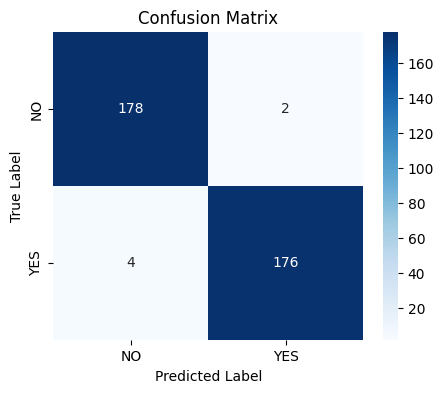

In [91]:
getConfMatrix(label_true_list_modelV1_2,label_predicted_list_modelV1_2,"ModelV1_2")

## Model V2.0

In [92]:
right_list_modelV2_0, wrong_list_modelV2_0, predicted_list_modelV2_0, elapsed_time_modelV2_0 = get_predictions(modelV2_0, test_loader)

Accuracy on the test set: 91.67%


In [95]:
elapsed_time_modelV2_0

7.346471150716146e-05

In [93]:
label_true_list_modelV2_0 ,label_predicted_list_modelV2_0  = tensorToLabel(right_list_modelV2_0,wrong_list_modelV2_0)

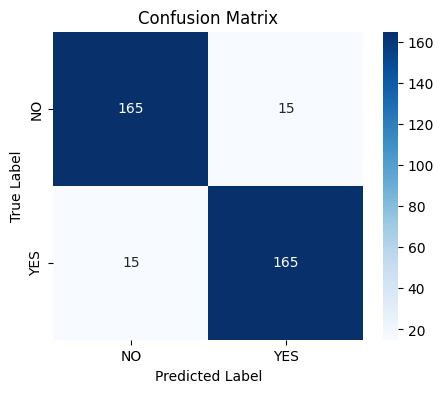

In [94]:
getConfMatrix(label_true_list_modelV2_0,label_predicted_list_modelV2_0,"ModelV2_0")

## Model V2.1

In [100]:
right_list_modelV2_1, wrong_list_modelV2_1, predicted_list_modelV2_1, elapsed_time_modelV2_1 = get_predictions(modelV2_1, test_loader)

Accuracy on the test set: 99.17%


In [101]:
elapsed_time_modelV2_1

6.909900241427951e-05

In [102]:
label_true_list_modelV2_1 ,label_predicted_list_modelV2_1  = tensorToLabel(right_list_modelV2_1,wrong_list_modelV2_1)

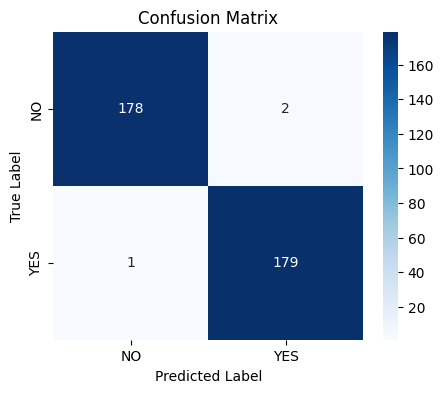

In [103]:
getConfMatrix(label_true_list_modelV2_1,label_predicted_list_modelV2_1,"ModelV2_1")

# Activation Map

## Setup 

In [38]:
import torch
from torch.utils.hooks import RemovableHandle

In [39]:
pip install grad-cam

  Using cached grad_cam-1.5.0-py3-none-any.whl
  Using cached ttach-0.0.3-py3-none-any.whl.metadata (5.2 kB)
  Using cached opencv_python-4.9.0.80-cp37-abi3-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (20 kB)
Using cached opencv_python-4.9.0.80-cp37-abi3-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (62.2 MB)
Using cached ttach-0.0.3-py3-none-any.whl (9.8 kB)
Note: you may need to restart the kernel to use updated packages.


In [40]:
from pytorch_grad_cam import GradCAM, HiResCAM, ScoreCAM, GradCAMPlusPlus, AblationCAM, XGradCAM, EigenCAM, FullGrad
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget
from pytorch_grad_cam.utils.image import show_cam_on_image
import PIL

In [58]:
def getheatMap(right_list,wrong_list,model,target_layers):

    cam = GradCAM(model=model, target_layers=target_layers)
    transformfunc = T.ToPILImage()
    
    # WRONGLY YES
    plt.title("WRONG Predicted : YES")
    wrongYES_predicted_images = [tup[0] for tup in wrong_list if tup[1] == torch.tensor(1)]
    targets = [ClassifierOutputTarget(torch.tensor(1))]
    for tempImg in wrongYES_predicted_images:
        input_tensor = tempImg.unsqueeze(0)
        input_image = transformfunc(tempImg)

        input_image = np.float32(input_image) / 255.0

        # Generate CAM
        grayscale_cams = cam(input_tensor=input_tensor, targets=targets)
        cam_image = show_cam_on_image(input_image, grayscale_cams[0, :], use_rgb=True)

        cam_np = np.uint8(255 * grayscale_cams[0, :])
        cam_np = cv2.merge([cam_np, cam_np, cam_np])

        # Display the original image & the associated CAM
        images = np.hstack((np.uint8(255 * input_image), cam_image))
        plt.imshow(images)
        plt.show()
    
    # WRONGLY NO
    plt.title("WRONG Predicted : NO")
    wrongNO_predicted_images = [tup[0] for tup in wrong_list if tup[1] == torch.tensor(0)]
    targets = [ClassifierOutputTarget(torch.tensor(0))]
    for tempImg in wrongNO_predicted_images:
        input_tensor = tempImg.unsqueeze(0)
        input_image = transformfunc(tempImg)

        input_image = np.float32(input_image) / 255.0

        # Generate CAM
        grayscale_cams = cam(input_tensor=input_tensor, targets=targets)
        cam_image = show_cam_on_image(input_image, grayscale_cams[0, :], use_rgb=True)

        cam_np = np.uint8(255 * grayscale_cams[0, :])
        cam_np = cv2.merge([cam_np, cam_np, cam_np])

        # Display the original image & the associated CAM
        images = np.hstack((np.uint8(255 * input_image), cam_image))
        plt.imshow(images)
        plt.show()
        
    # RIGHTLY YES
    plt.title("RIGHT Predicted : YES")
    rightYES_predicted_images = [tup[0] for tup in right_list if tup[1] == torch.tensor(1)]
    targets = [ClassifierOutputTarget(torch.tensor(1))]
    for tempImg in rightYES_predicted_images:
        input_tensor = tempImg.unsqueeze(0)
        input_image = transformfunc(tempImg)
        input_image = np.float32(input_image) / 255.0

        # Generate CAM
        grayscale_cams = cam(input_tensor=input_tensor, targets=targets)
        cam_image = show_cam_on_image(input_image, grayscale_cams[0, :], use_rgb=True)

        cam_np = np.uint8(255 * grayscale_cams[0, :])
        cam_np = cv2.merge([cam_np, cam_np, cam_np])

        # Display the original image & the associated CAM
        images = np.hstack((np.uint8(255 * input_image), cam_image))
        plt.imshow(images)
        plt.show()
        
    # RIGHTLY NO 
    plt.title("RIGHT Predicted : NO")
    rightNO_predicted_images = [tup[0] for tup in right_list if tup[1] == torch.tensor(0)]
    targets = [ClassifierOutputTarget(torch.tensor(0))]
    for tempImg in rightNO_predicted_images:
        input_tensor = tempImg.unsqueeze(0)
        input_image = transformfunc(tempImg)
        input_image = np.float32(input_image) / 255.0

        # Generate CAM
        grayscale_cams = cam(input_tensor=input_tensor, targets=targets)
        cam_image = show_cam_on_image(input_image, grayscale_cams[0, :], use_rgb=True)

        cam_np = np.uint8(255 * grayscale_cams[0, :])
        cam_np = cv2.merge([cam_np, cam_np, cam_np])

        # Display the original image & the associated CAM
        images = np.hstack((np.uint8(255 * input_image), cam_image))
        plt.imshow(images)
        plt.show()

## HeatMap V1.0

In [42]:
right_list_modelV1_0, wrong_list_modelV1_0, predicted_list_modelV1_0, elapsed_time_modelV1_0 = get_predictions(modelV1_0, test_loader)

Accuracy on the test set: 97.22%


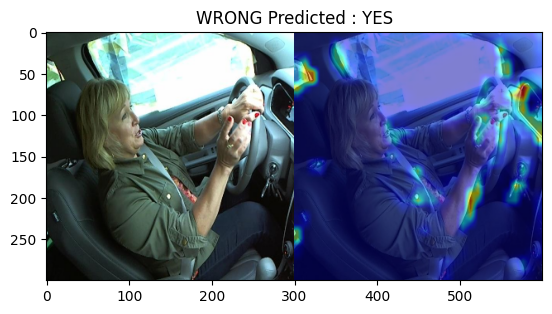

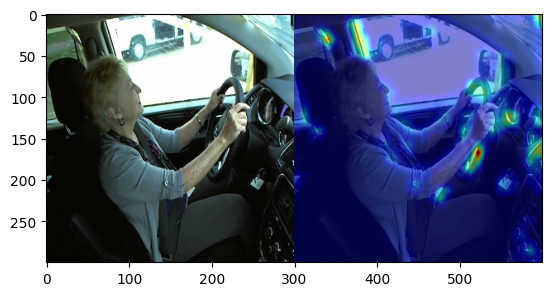

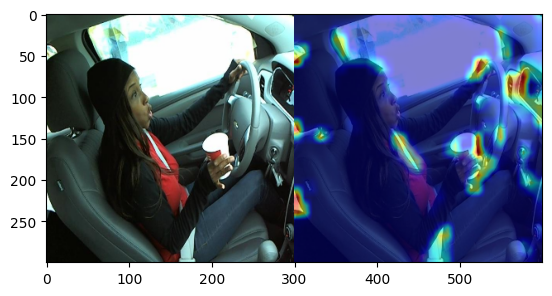

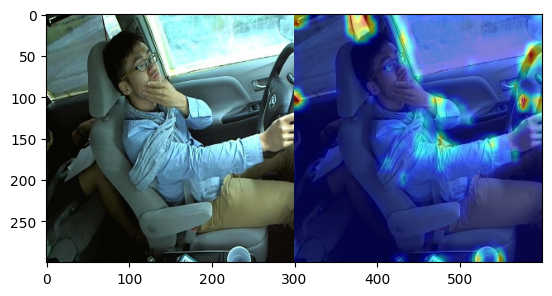

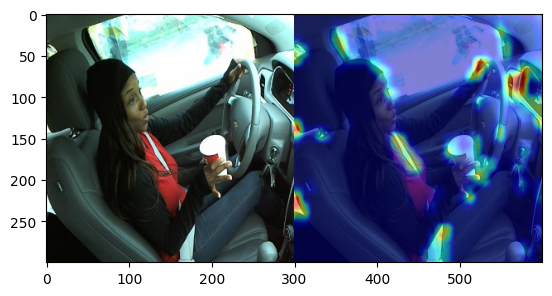

...

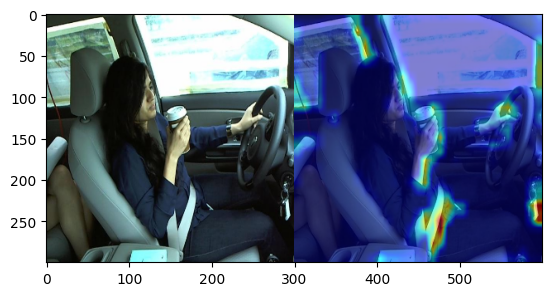

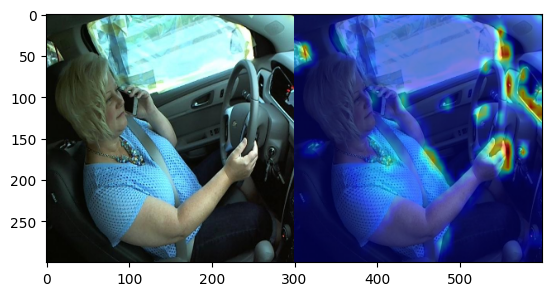

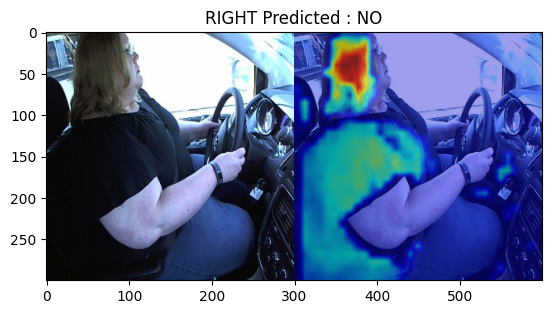

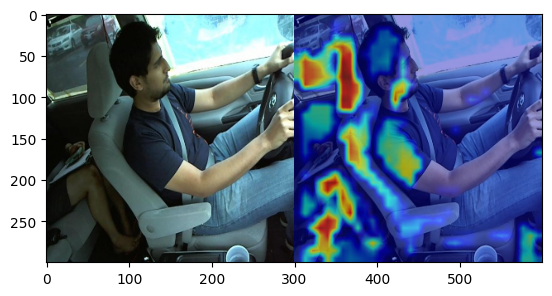

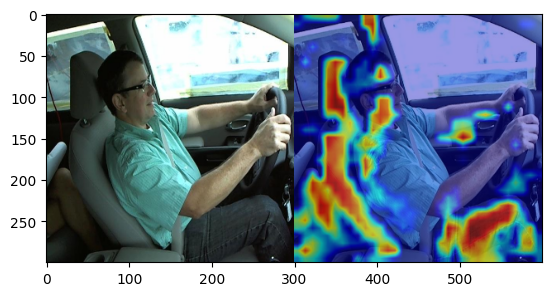

In [59]:
modelV1_0.eval()
target_layers = [modelV1_0.conv_layer_2]
getheatMap(right_list_modelV1_0[:10],wrong_list_modelV1_0,modelV1_0,target_layers)

## HeatMap V1.1

In [53]:
right_list_modelV1_1, wrong_list_modelV1_1, predicted_list_modelV1_1, elapsed_time_modelV1_1 = get_predictions(modelV1_1, test_loader)

Accuracy on the test set: 98.06%


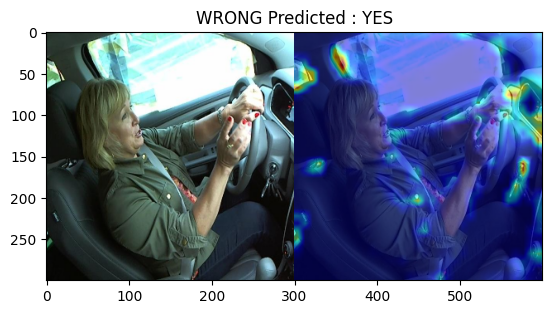

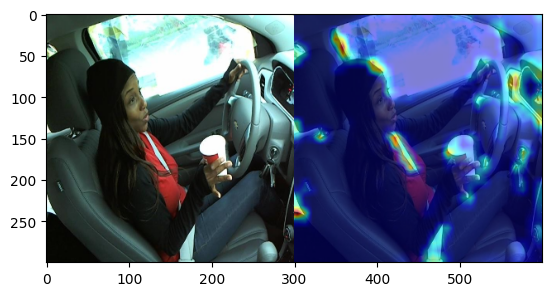

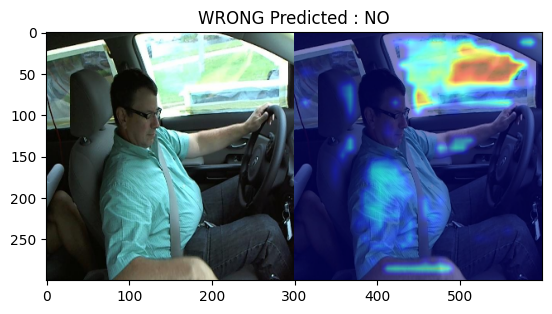

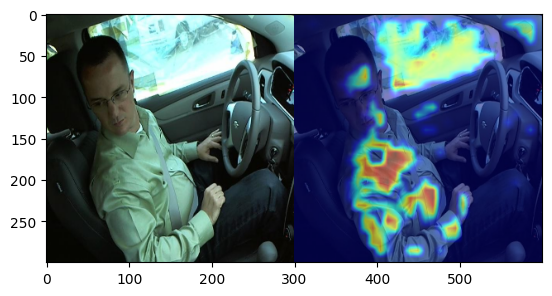

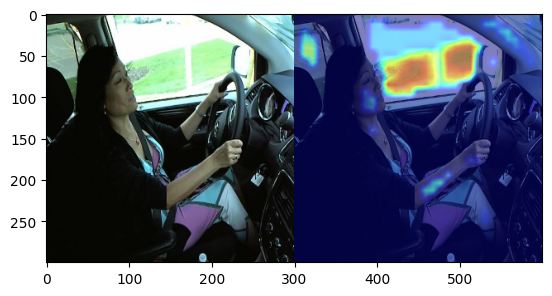

...

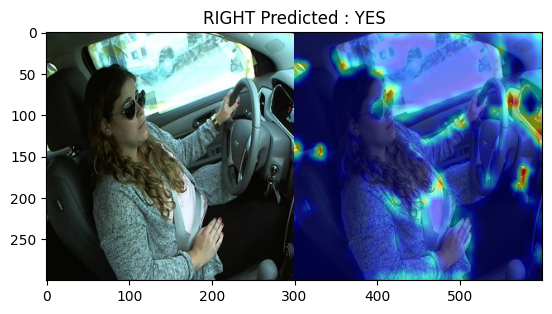

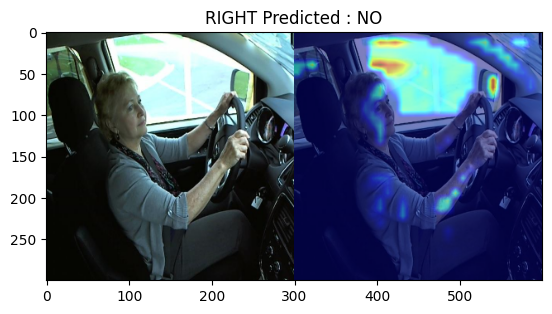

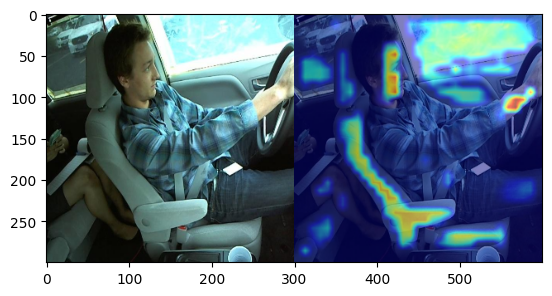

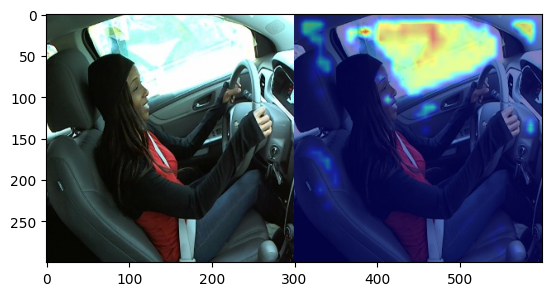

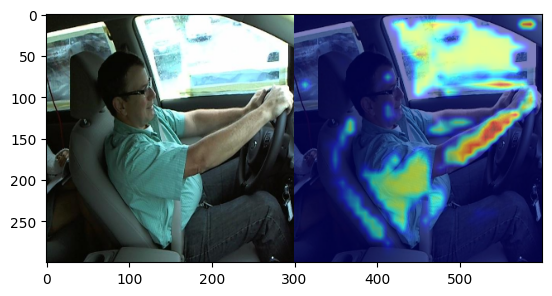

In [64]:
modelV1_1.eval()
target_layers = [modelV1_1.conv_layer_2]
getheatMap(right_list_modelV1_1[:5],wrong_list_modelV1_1,modelV1_1,target_layers)

## HeatMap V1.2

In [61]:
right_list_modelV1_2, wrong_list_modelV1_2, predicted_list_modelV1_2, elapsed_time_modelV1_2 = get_predictions(modelV1_2, test_loader)

Accuracy on the test set: 98.33%


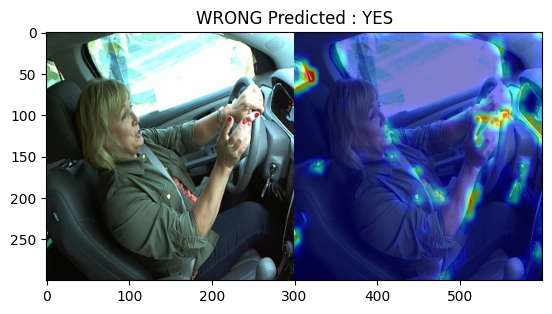

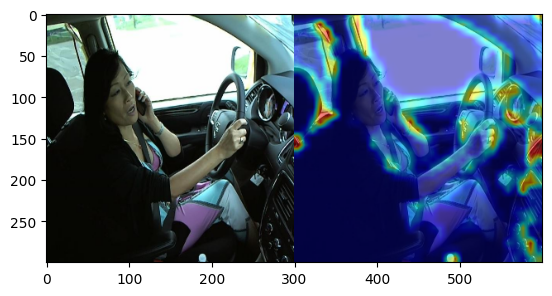

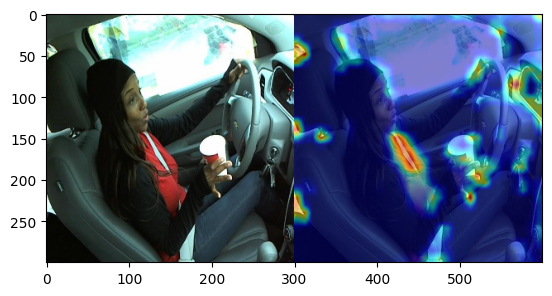

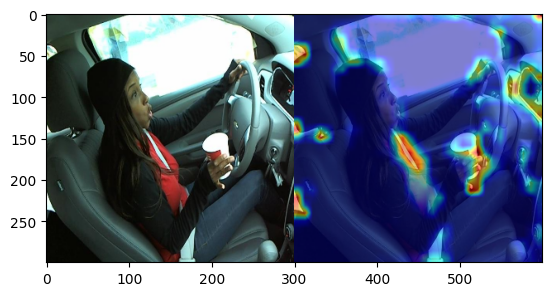

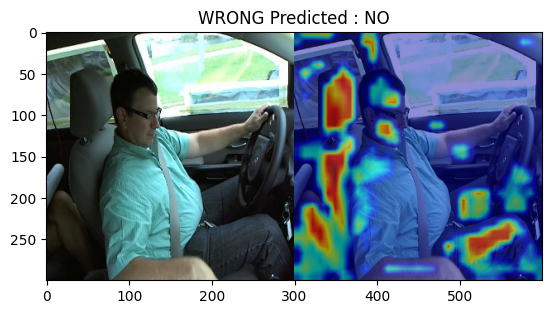

...

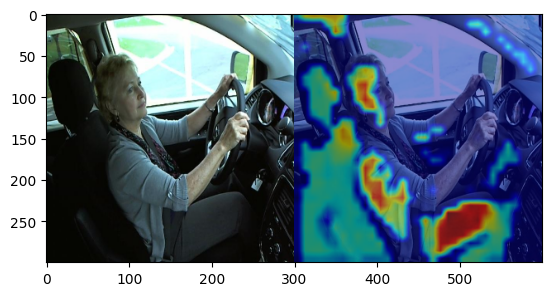

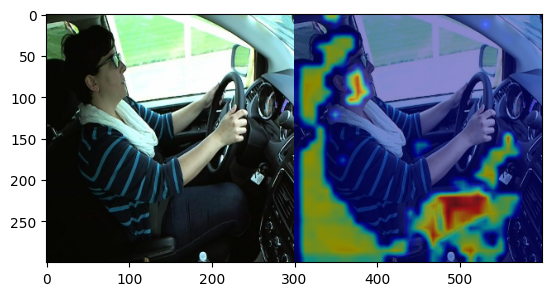

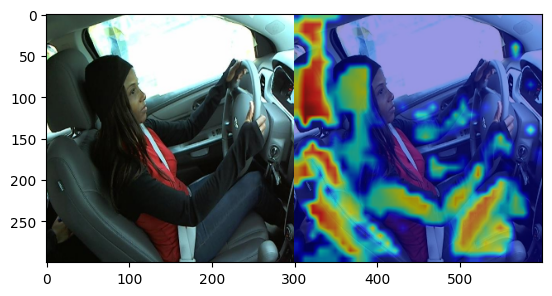

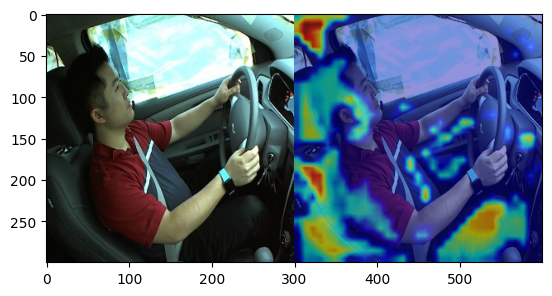

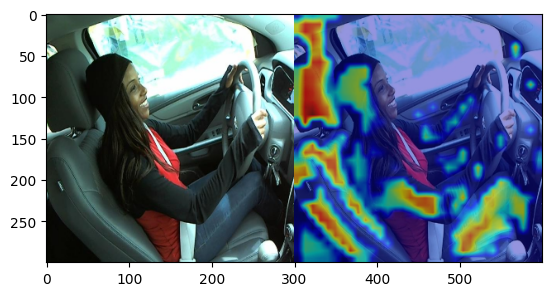

In [67]:
modelV1_2.eval()
target_layers = [modelV1_2.conv_layer_2]
getheatMap(right_list_modelV1_2[:10],wrong_list_modelV1_2,modelV1_2,target_layers)

## HeatMap V2.0

In [68]:
right_list_modelV2_0, wrong_list_modelV2_0, predicted_list_modelV2_0, elapsed_time_modelV2_0 = get_predictions(modelV2_0, test_loader)

Accuracy on the test set: 91.67%


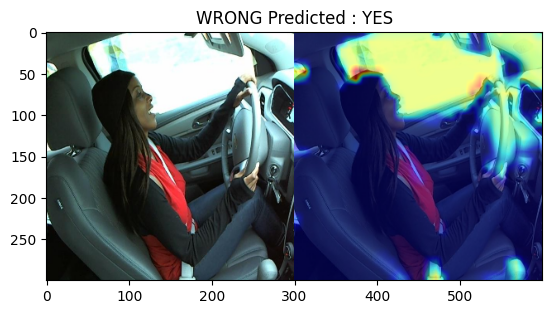

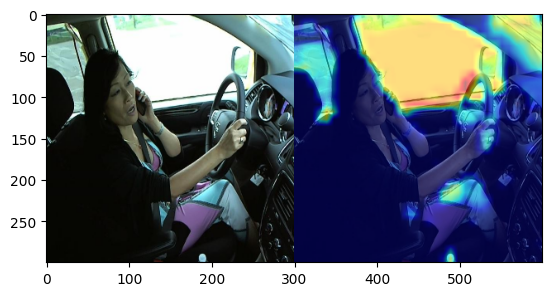

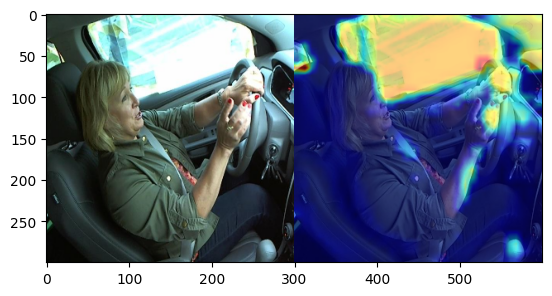

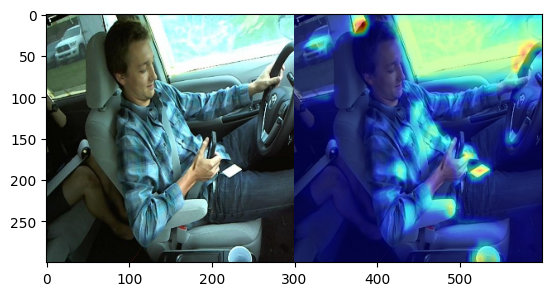

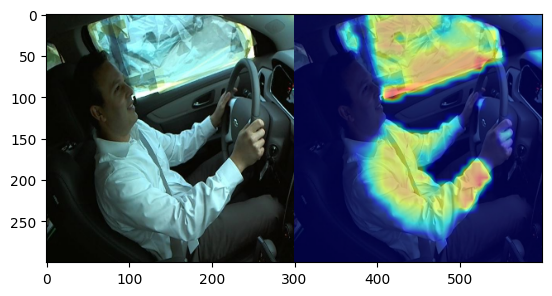

...

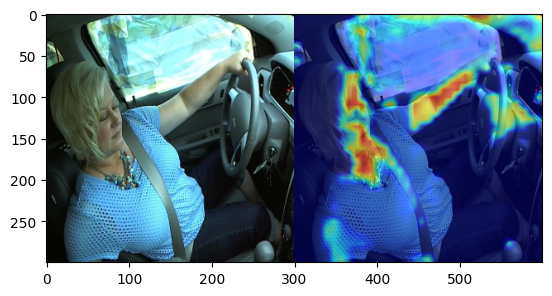

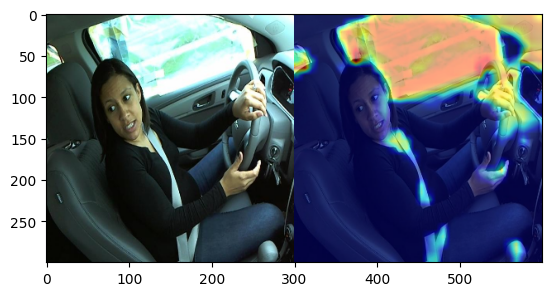

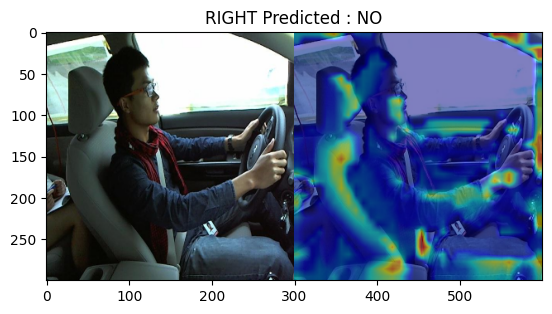

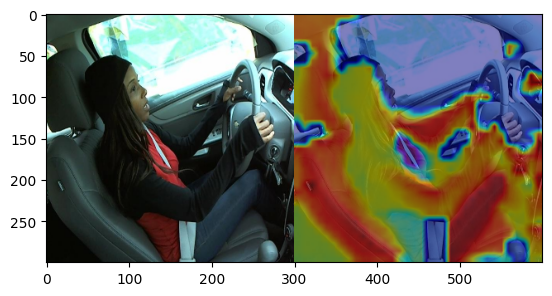

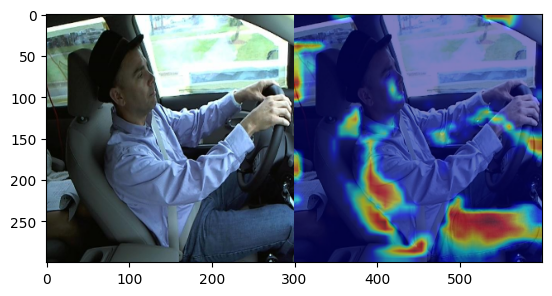

In [69]:
modelV2_0.eval()
target_layers = [modelV2_0.conv_layer_2]
getheatMap(right_list_modelV2_0[:10],wrong_list_modelV2_0,modelV2_0,target_layers)

## HeatMap V2.1

In [70]:
right_list_modelV2_1, wrong_list_modelV2_1, predicted_list_modelV2_1, elapsed_time_modelV2_1 = get_predictions(modelV2_1, test_loader)

Accuracy on the test set: 99.17%


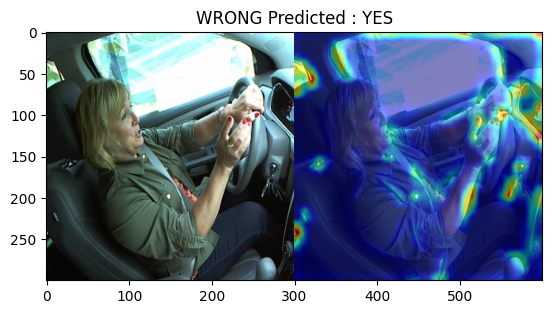

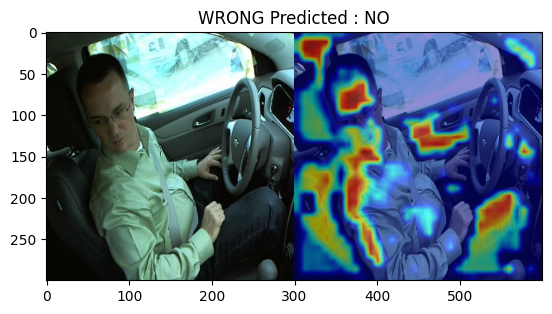

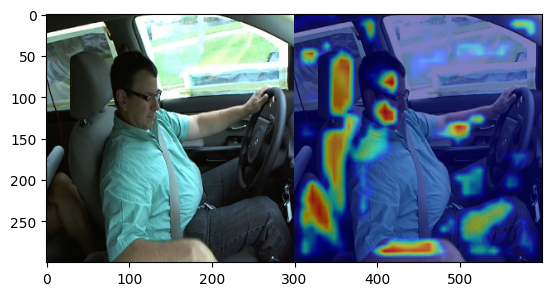

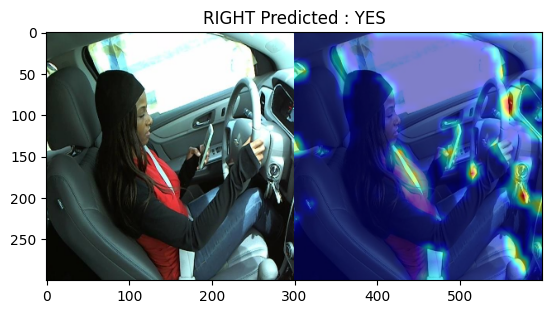

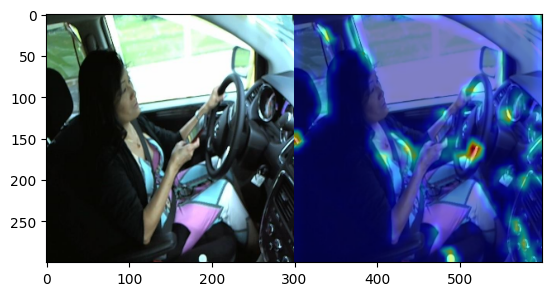

...

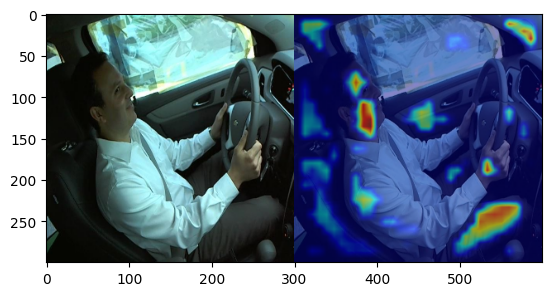

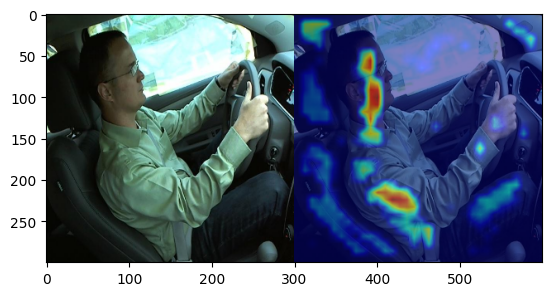

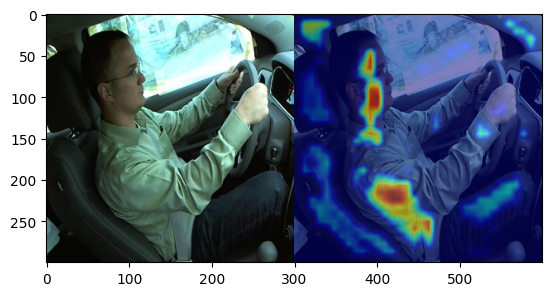

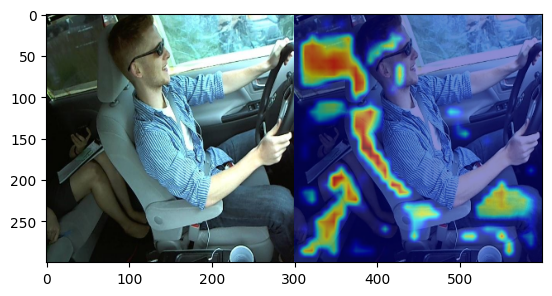

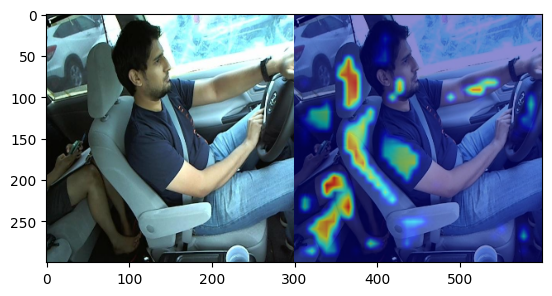

In [71]:
modelV2_1.eval()
target_layers = [modelV2_1.conv_layer_2]
getheatMap(right_list_modelV2_1[:10],wrong_list_modelV2_1,modelV2_1,target_layers)